<a href="https://colab.research.google.com/github/aruk3002/Customer-Purchase-Behavior-Analysis/blob/main/Customer_Purchase_Behavior_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ***Customer Purchase Behavior Analysis using Descriptive Statistics***

##**📋 Project Overview**

In this project, I analyze customer purchase behavior using descriptive statistics and probability theory. The dataset includes various customer attributes such as demographics, income levels, household details, and product purchase history across different categories.

The goal of this analysis is to identify meaningful patterns and relationships in the data that can support strategic decision-making—particularly to enhance marketing efforts and improve the acceptance rate of promotional offers.

This project involves a complete data analysis pipeline, starting from data cleaning and preprocessing, followed by exploratory data analysis, statistical summarization, probability modeling, and customer segmentation. The insights gained from this analysis aim to help the company better understand its customer base and optimize its targeting strategies.

##**🎯 Project Objectives**

The primary objective of this project is to analyze customer data using descriptive statistics and probability concepts in order to uncover actionable insights. Here's what I aim to accomplish through this analysis:

- 📌 **Clean and preprocess** the dataset by handling missing values and ensuring consistent data types  
- 📌 Perform **descriptive analysis** to explore customer demographics and purchasing behavior  
- 📌 Calculate **measures of central tendency and dispersion** to understand data distribution  
- 📌 Identify and apply **appropriate probability distributions** to relevant variables  
- 📌 Detect and handle **potential outliers** that may affect the quality of analysis  
- 📌 Explore relationships between customer attributes and their spending habits  
- 📌 Conduct **customer segmentation** based on behaviors and demographic factors  
- 📌 Visualize insights clearly and provide **data-driven recommendations** for improving offer acceptance rates  


## ***Let's Begin !***

###**Libraries**

In [ ]:
!pip install ydata_profiling

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 400.1/400.1 kB 8.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 8.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 687.8/687.8 kB 25.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.2/43.2 kB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 30.0 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=6546c33d4d53714f9e56e910d6ae23da56d2d0b510409955c2baeb2e1138c6da
  Stored in directory: /root/.cache/pip/wheels/8d/55/1a/19cd535375ed1ede0c996405ebffe34b196d78e2d9545723a2
Successfully built htmlmin


In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from datetime import datetime
import plotly.express as px
from ydata_profiling import ProfileReport
from IPython.display import display

In [ ]:
import scipy.stats as stats

###**Loading Dataset**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
df = pd.read_excel("/content/drive/MyDrive/Superstore Marketing Data.xlsx")

In [ ]:
df.head(5)

,Id,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Response,Complain
0,1826,1970,Graduation,Divorced,84835.0,0,0,6/16/2014,0,189,...,111,189,218,1,4,4,6,1,1,0
1,1,1961,Graduation,Single,57091.0,0,0,6/15/2014,0,464,...,7,0,37,1,7,3,7,5,1,0
2,10476,1958,Graduation,Married,67267.0,0,1,5/13/2014,0,134,...,15,2,30,1,3,2,5,2,0,0
3,1386,1967,Graduation,Together,32474.0,1,1,########,0,10,...,0,0,0,1,1,0,2,7,0,0
4,5371,1989,Graduation,Single,21474.0,1,0,########,0,6,...,11,0,34,2,3,1,2,7,1,0


###**Data Exploration and Initial Analysis**

**Preview the Dataset**

In [ ]:
pd.set_option('display.max_columns', None)  # Show all columns

In [ ]:
df.sample(5)

,Id,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Response,Complain
1837,8372,1974,Graduation,Married,34421.0,1,0,########,81,3,3,7,6,2,9,1,1,0,2,7,0,0
809,4426,1975,Graduation,Single,55801.0,1,1,9/22/2013,35,367,4,51,6,4,95,6,7,2,6,7,0,0
639,10343,1991,2n Cycle,Single,61618.0,0,0,9/29/2012,27,605,91,399,0,45,205,2,3,6,8,3,0,0
2161,10500,1984,Graduation,Married,31761.0,1,0,########,96,19,1,20,16,14,28,2,3,0,4,5,0,0
284,2715,1966,Master,Divorced,29435.0,1,1,########,11,70,3,37,4,2,64,4,3,2,2,9,1,0


**Check Shape and Data Types**

In [ ]:
df.shape  # Rows and columns

(2240, 22)

In [ ]:
df.info()  # Data types and non-null counts

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 22 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Id                   2240 non-null   int64  
 1   Year_Birth           2240 non-null   int64  
 2   Education            2240 non-null   object 
 3   Marital_Status       2240 non-null   object 
 4   Income               2216 non-null   float64
 5   Kidhome              2240 non-null   int64  
 6   Teenhome             2240 non-null   int64  
 7   Dt_Customer          2240 non-null   object 
 8   Recency              2240 non-null   int64  
 9   MntWines             2240 non-null   int64  
 10  MntFruits            2240 non-null   int64  
 11  MntMeatProducts      2240 non-null   int64  
 12  MntFishProducts      2240 non-null   int64  
 13  MntSweetProducts     2240 non-null   int64  
 14  MntGoldProds         2240 non-null   int64  
 15  NumDealsPurchases    2240 non-null   i

**Summary Statistics**

In [ ]:
df.describe()  # For numeric columns

,Id,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Response,Complain
count,2240.000000,2240.000000,2216.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000
mean,5592.159821,1968.805804,52247.251354,0.444196,0.506250,49.109375,303.935714,26.302232,166.950000,37.525446,27.062946,44.021875,2.325000,4.084821,2.662054,5.790179,5.316518,0.149107,0.009375
std,3246.662198,11.984069,25173.076661,0.538398,0.544538,28.962453,336.597393,39.773434,225.715373,54.628979,41.280498,52.167439,1.932238,2.778714,2.923101,3.250958,2.426645,0.356274,0.096391
min,0.000000,1893.000000,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2828.250000,1959.000000,35303.000000,0.000000,0.000000,24.000000,23.750000,1.000000,16.000000,3.000000,1.000000,9.000000,1.000000,2.000000,0.000000,3.000000,3.000000,0.000000,0.000000
50%,5458.500000,1970.000000,51381.500000,0.000000,0.000000,49.000000,173.500000,8.000000,67.000000,12.000000,8.000000,24.000000,2.000000,4.000000,2.000000,5.000000,6.000000,0.000000,0.000000
75%,8427.750000,1977.000000,68522.000000,1.000000,1.000000,74.000000,504.250000,33.000000,232.000000,50.000000,33.000000,56.000000,3.000000,6.000000,4.000000,8.000000,7.000000,0.000000,0.000000
max,11191.000000,1996.000000,666666.000000,2.000000,2.000000,99.000000,1493.000000,199.000000,1725.000000,259.000000,263.000000,362.000000,15.000000,27.000000,28.000000,13.000000,20.000000,1.000000,1.000000


In [ ]:
df.describe(include='object')  # For categorical columns

,Education,Marital_Status,Dt_Customer
count,2240,2240,2240
unique,5,8,401
top,Graduation,Married,########
freq,1127,864,916


**Check for Missing Values**

In [ ]:
df.isnull().sum()

,0
Id,0
Year_Birth,0
Education,0
Marital_Status,0
Income,24
Kidhome,0
Teenhome,0
Dt_Customer,0
Recency,0
MntWines,0


In [ ]:
df.isnull().mean() * 100  # Percentage of missing values

,0
Id,0.000000
Year_Birth,0.000000
Education,0.000000
Marital_Status,0.000000
Income,1.071429
Kidhome,0.000000
Teenhome,0.000000
Dt_Customer,0.000000
Recency,0.000000
MntWines,0.000000


**Check for Duplicates**

In [ ]:
df.duplicated().sum()

np.int64(0)

 **Check Unique Values**

In [ ]:
df.nunique()

,0
Id,2240
Year_Birth,59
Education,5
Marital_Status,8
Income,1974
Kidhome,3
Teenhome,3
Dt_Customer,401
Recency,100
MntWines,776


 **Check Column Names & Clean**

In [ ]:
df.columns

Index(['Id', 'Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Dt_Customer', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'Response', 'Complain'],
      dtype='object')

**Visual Quick Checks**

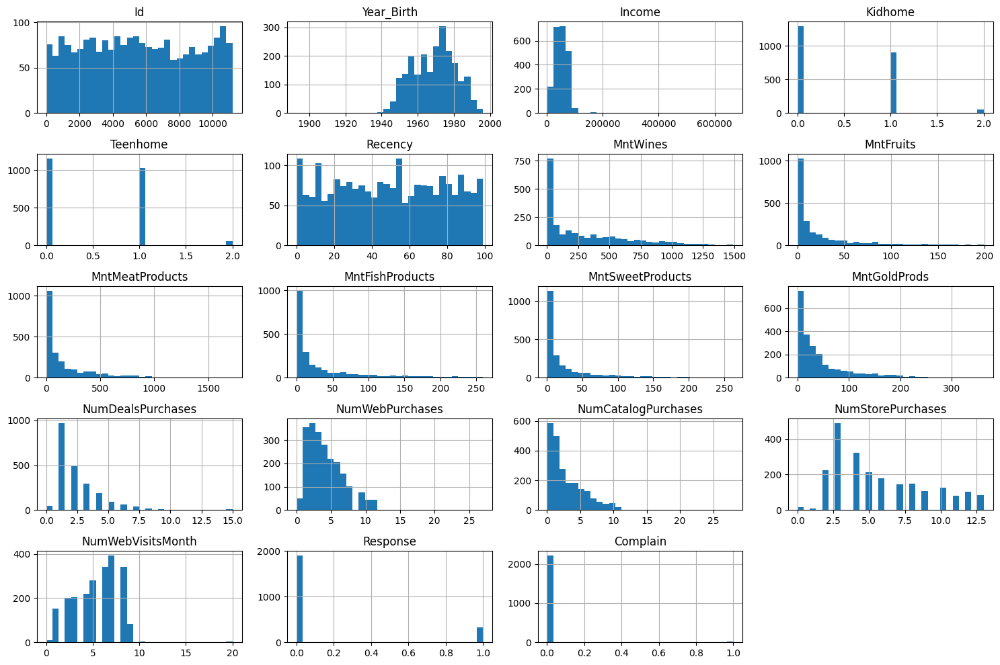

In [ ]:
_ = df.hist(bins=30, figsize=(15, 10))  # assign to _
plt.tight_layout()  # better spacing
plt.show()



---



###**Task 1 - Basic CleanUp🧹📊**



This task focuses on preparing the dataset for analysis by performing basic data cleaning and formatting. The goal is to ensure the data is accurate, consistent, and ready for further analysis. This involves checking data types, handling missing values, and exploring key demographic features like age, education level, and marital status using descriptive statistics and visualizations.

*Data Type Conversion :*

In [ ]:
df.dtypes

,0
Id,int64
Year_Birth,int64
Education,object
Marital_Status,object
Income,float64
Kidhome,int64
Teenhome,int64
Dt_Customer,object
Recency,int64
MntWines,int64


In [ ]:
# Get the current year dynamically
current_year = datetime.now().year

# Create the Age column
df['Age'] = current_year - df['Year_Birth']

In [ ]:
# Convert 'Dt_Customer' to datetime, treating the first part of the string as the day
df['Dt_Customer'] = pd.to_datetime(df['Dt_Customer'], errors='coerce', dayfirst=True)

<ipython-input-22-08638f4e8756>:2: UserWarning: Parsing dates in %m/%d/%Y format when dayfirst=True was specified. Pass `dayfirst=False` or specify a format to silence this warning.
  df['Dt_Customer'] = pd.to_datetime(df['Dt_Customer'], errors='coerce', dayfirst=True)


*Handling Missing Values :*

In [ ]:
df.isnull().sum()

,0
Id,0
Year_Birth,0
Education,0
Marital_Status,0
Income,24
Kidhome,0
Teenhome,0
Dt_Customer,916
Recency,0
MntWines,0


In [ ]:
# Fill missing values in 'Income' with the median value
df['Income'].fillna(df['Income'].median(), inplace=True)

<ipython-input-24-9187a91dfaf1>:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['Income'].fillna(df['Income'].median(), inplace=True)


*Customer Demographics Analysis: Age, Education, and Marital Status Distribution :*

In [ ]:
df.describe()

,Id,Year_Birth,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Response,Complain,Age
count,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,1324,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000
mean,5592.159821,1968.805804,52237.975446,0.444196,0.506250,2013-07-19 09:00:32.628398848,49.109375,303.935714,26.302232,166.950000,37.525446,27.062946,44.021875,2.325000,4.084821,2.662054,5.790179,5.316518,0.149107,0.009375,56.194196
min,0.000000,1893.000000,1730.000000,0.000000,0.000000,2012-07-30 00:00:00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,29.000000
25%,2828.250000,1959.000000,35538.750000,0.000000,0.000000,2013-01-26 00:00:00,24.000000,23.750000,1.000000,16.000000,3.000000,1.000000,9.000000,1.000000,2.000000,0.000000,3.000000,3.000000,0.000000,0.000000,48.000000
50%,5458.500000,1970.000000,51381.500000,0.000000,0.000000,2013-07-21 12:00:00,49.000000,173.500000,8.000000,67.000000,12.000000,8.000000,24.000000,2.000000,4.000000,2.000000,5.000000,6.000000,0.000000,0.000000,55.000000
75%,8427.750000,1977.000000,68289.750000,1.000000,1.000000,2014-01-15 00:00:00,74.000000,504.250000,33.000000,232.000000,50.000000,33.000000,56.000000,3.000000,6.000000,4.000000,8.000000,7.000000,0.000000,0.000000,66.000000
max,11191.000000,1996.000000,666666.000000,2.000000,2.000000,2014-06-29 00:00:00,99.000000,1493.000000,199.000000,1725.000000,259.000000,263.000000,362.000000,15.000000,27.000000,28.000000,13.000000,20.000000,1.000000,1.000000,132.000000
std,3246.662198,11.984069,25037.955891,0.538398,0.544538,NaN,28.962453,336.597393,39.773434,225.715373,54.628979,41.280498,52.167439,1.932238,2.778714,2.923101,3.250958,2.426645,0.356274,0.096391,11.984069


In [ ]:
df.describe(include='object')

,Education,Marital_Status
count,2240,2240
unique,5,8
top,Graduation,Married
freq,1127,864


In [ ]:
df['Education'].value_counts()

,count
Education,
Graduation,1127
PhD,486
Master,370
2n Cycle,203
Basic,54


In [ ]:
df['Marital_Status'].value_counts()

,count
Marital_Status,
Married,864
Together,580
Single,480
Divorced,232
Widow,77
Alone,3
YOLO,2
Absurd,2


In [ ]:
# Replace 'Alone' with 'Single' as it likely means the same
df['Marital_Status'] = df['Marital_Status'].replace('Alone', 'Single')

# Remove rows where Marital_Status is 'YOLO' or 'Absurd' as they are invalid and rare
df= df[~df['Marital_Status'].isin(['YOLO', 'Absurd'])]

<ipython-input-127-3f2f5c3fc4b3>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
# A Histogram for Age
fig = px.histogram(df, x='Age', nbins=30, title='Distribution of Age', labels={'Age': 'Age'})
fig.update_layout(xaxis_title='Age', yaxis_title='Frequency')
fig.show()

In [ ]:
# Group by Education and count occurrences
education_counts = df['Education'].value_counts().reset_index()
education_counts.columns = ['Education', 'Count']

# A Bar Plot sorted by frequency (descending)
fig = px.bar(education_counts, x='Education', y='Count', title='Distribution of Education Levels',
             labels={'Education': 'Education', 'Count': 'Frequency'}, color='Education', color_discrete_sequence=px.colors.qualitative.Pastel)

fig.update_layout(xaxis_title='Education', yaxis_title='Frequency')
fig.show()

In [ ]:
# Group by Marital Status and count occurrences
marital_counts = df['Marital_Status'].value_counts().reset_index()
marital_counts.columns = ['Marital_Status', 'Count']

# A Bar Plot sorted by frequency (descending)
fig = px.bar(marital_counts, x='Marital_Status', y='Count', title='Distribution of Marital Status',
             labels={'Marital_Status': 'Marital Status', 'Count': 'Frequency'}, color='Marital_Status', color_discrete_sequence=px.colors.qualitative.Pastel)

fig.update_layout(xaxis_title='Marital Status', yaxis_title='Frequency')
fig.show()

*Cleaned and Preprocessed Dataset :*

This section outlines the data cleaning and preprocessing steps undertaken to prepare the dataset for analysis.

**1. Handling Missing Values**

- **Income**:  
  The "Income" column contained missing values. These were addressed using **median imputation**, a method suitable for numerical variables, as it is robust against outliers and helps maintain the central tendency of the data.

- **Dt_Customer**:  
  The "Dt_Customer" column had approximately **40.8% missing values**. Instead of imputing or dropping these entries, the missing values were left as **NaT (Not a Time)** to preserve data type consistency and avoid introducing bias. This decision allows for future analysis that may better inform how to handle these entries.

**2. Data Type Consistency**

- **Year_Birth**:  
  Initially an integer, this column was used to derive a new "Age" feature by subtracting the birth year from the current year. This transformation facilitates more intuitive analysis of customer demographics.

- **Dt_Customer**:  
  Originally stored as strings, this column was converted to the **datetime** data type using the format `"%d/%m/%y"`. Invalid or improperly formatted entries were coerced to NaT to maintain consistency.

- **Categorical Columns**:  
  Columns such as "Education", "Marital_Status", and "Complain" were verified for appropriate data types. Unique values were inspected to ensure there were no typos or inconsistencies in category labels.



*Summary of Basic Statistics :*


This section provides key statistical information for important numerical and categorical variables in the dataset.

In [ ]:
# Generate summary statistics for all numerical columns, excluding 'Dt_Customer'
# 'Dt_Customer' is dropped because it is a datetime column and can't be rounded
df.drop(['Dt_Customer'], axis=1).describe().T.round(2)

,count,mean,std,min,25%,50%,75%,max
Id,2240.0,5592.16,3246.66,0.0,2828.25,5458.5,8427.75,11191.0
Year_Birth,2240.0,1968.81,11.98,1893.0,1959.00,1970.0,1977.00,1996.0
Income,2240.0,52237.98,25037.96,1730.0,35538.75,51381.5,68289.75,666666.0
Kidhome,2240.0,0.44,0.54,0.0,0.00,0.0,1.00,2.0
Teenhome,2240.0,0.51,0.54,0.0,0.00,0.0,1.00,2.0
Recency,2240.0,49.11,28.96,0.0,24.00,49.0,74.00,99.0
MntWines,2240.0,303.94,336.60,0.0,23.75,173.5,504.25,1493.0
MntFruits,2240.0,26.30,39.77,0.0,1.00,8.0,33.00,199.0
MntMeatProducts,2240.0,166.95,225.72,0.0,16.00,67.0,232.00,1725.0
MntFishProducts,2240.0,37.53,54.63,0.0,3.00,12.0,50.00,259.0


In [ ]:
# Generate summary statistics for all object columns
df.describe(include='object').T

,count,unique,top,freq
Education,2240,5,Graduation,1127
Marital_Status,2240,8,Married,864


In [ ]:
# Import and create an automated data profiling report using ydata-profiling

# Generate a profile report for the dataset
# This report includes statistics, missing values, correlations, and more
profile = ProfileReport(df, title="Customer Profile Report", explorative=True)

# Display the generated report directly inside the notebook
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 23/23 [00:00<00:00, 61.25it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

**1. Age Distribution**

- The **most common age group** is between **50 to 54 years**.
- There are a few **outliers** with extremely high ages between **125 to 129 years**, appearing only **2 to 3 times**, which may be due to incorrect data entry.

**2. Education Level**

- The **most frequent** education level is **Graduation**.
- The **least common** is **Basic**.
- A bar chart was used to show the frequency of each education category.

**3. Marital Status**

- **Married** customers form the **largest group**.
- **Widow** status is the **least common**.
- The distribution was visualized using a bar chart for better understanding.




---



###**Task 2 - Descriptive Statistics 📊**

This task aims to explore the key numerical variables by calculating measures of central tendency (mean, median, mode) and measures of dispersion (variance and standard deviation). These statistics help understand the typical values and spread of the data. Additionally, this task involves detecting and examining any outliers that may affect the overall analysis.

Calculate Central Tendency and Dispersion :

In [ ]:
# Select only numeric columns (ensures no strings like 'Graduation')
df_numeric = df.select_dtypes(include=['int64', 'float64'])

df_numeric.drop(["Id","Year_Birth"], axis=1, inplace=True)
# Calculate all required statistics and round them
descriptive_summary = pd.DataFrame({
    'Mean': df_numeric.mean(),
    'Median': df_numeric.median(),
    'Mode': df_numeric.mode().iloc[0],
    'Standard Deviation': df_numeric.std()
})
# Display the summary
descriptive_summary.round(2)

,Mean,Median,Mode,Standard Deviation
Income,52237.98,51381.5,51381.5,25037.96
Kidhome,0.44,0.0,0.0,0.54
Teenhome,0.51,0.0,0.0,0.54
Recency,49.11,49.0,56.0,28.96
MntWines,303.94,173.5,2.0,336.60
MntFruits,26.30,8.0,0.0,39.77
MntMeatProducts,166.95,67.0,7.0,225.72
MntFishProducts,37.53,12.0,0.0,54.63
MntSweetProducts,27.06,8.0,0.0,41.28
MntGoldProds,44.02,24.0,1.0,52.17


In [ ]:
for i in df_numeric.columns:
  print(f"{i}  =  {round(df_numeric[i].var(),2)}")

Income  =  626899235.18
Kidhome  =  0.29
Teenhome  =  0.3
Recency  =  838.82
MntWines  =  113297.8
MntFruits  =  1581.93
MntMeatProducts  =  50947.43
MntFishProducts  =  2984.33
MntSweetProducts  =  1704.08
MntGoldProds  =  2721.44
NumDealsPurchases  =  3.73
NumWebPurchases  =  7.72
NumCatalogPurchases  =  8.54
NumStorePurchases  =  10.57
NumWebVisitsMonth  =  5.89
Response  =  0.13
Complain  =  0.01
Age  =  143.62


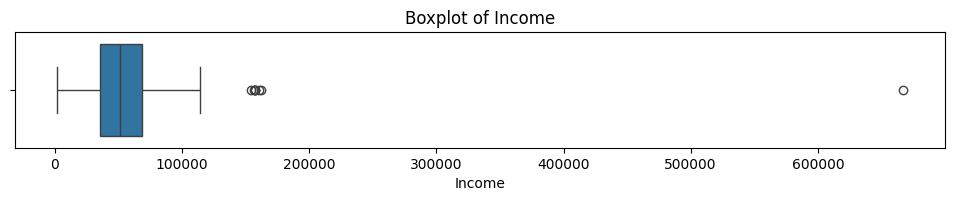

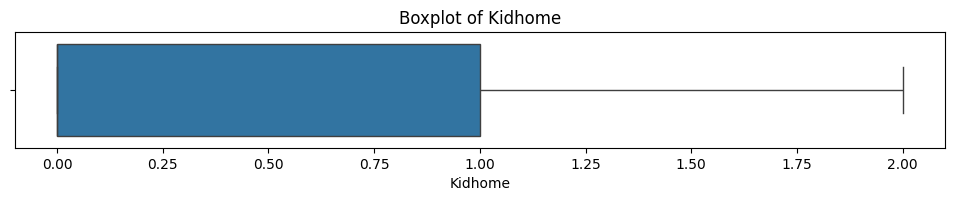

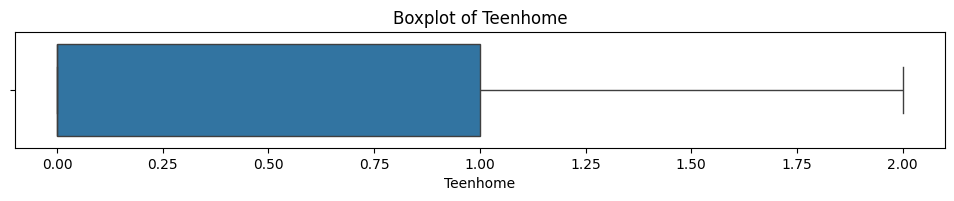

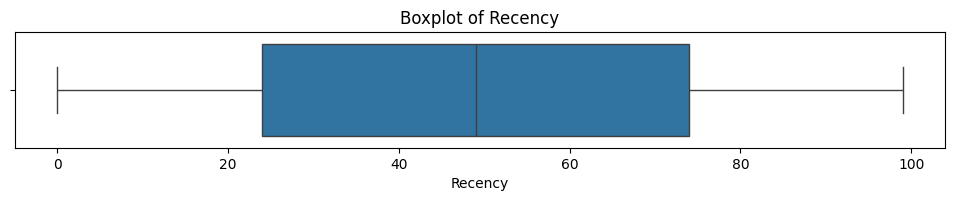

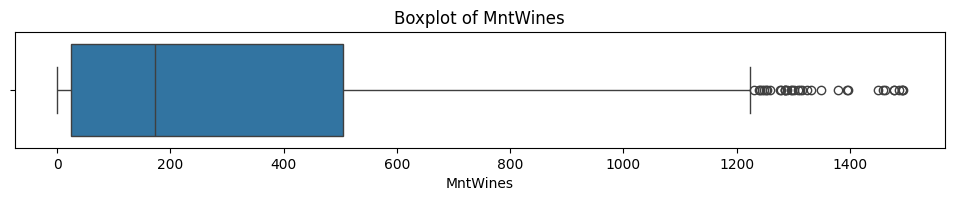

...

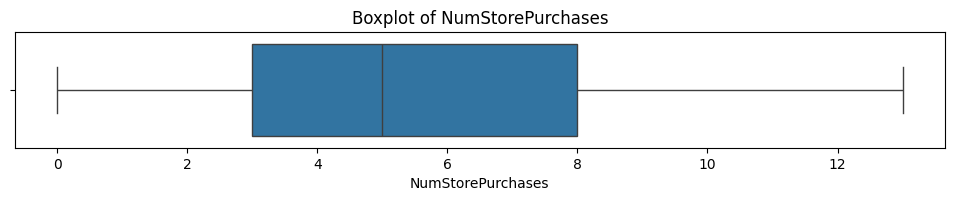

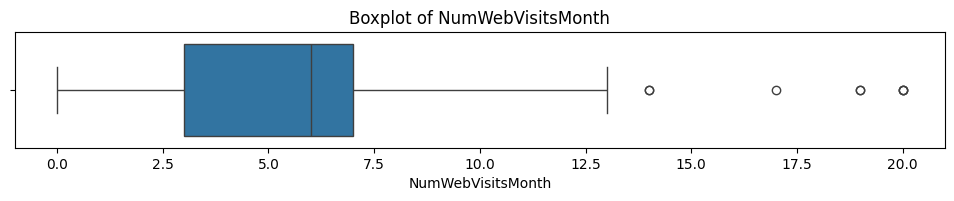

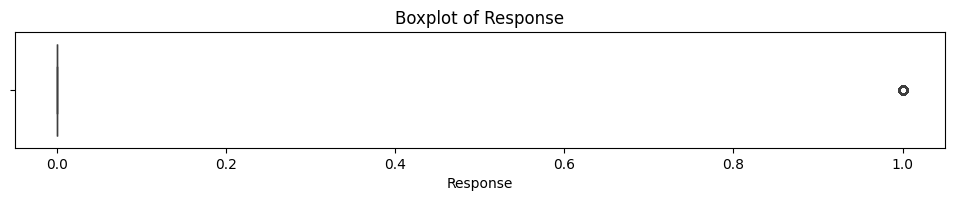

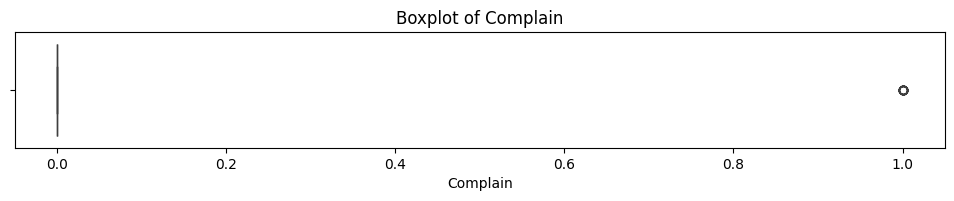

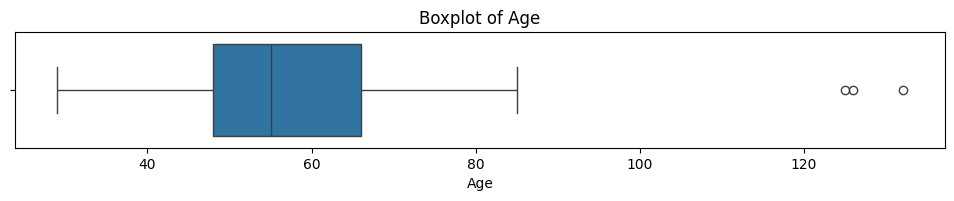

In [ ]:
for col in df_numeric:
    plt.figure(figsize=(12, 1.5))
    sns.boxplot(x=df[col])
    plt.title(f'Boxplot of {col}')
    plt.show()

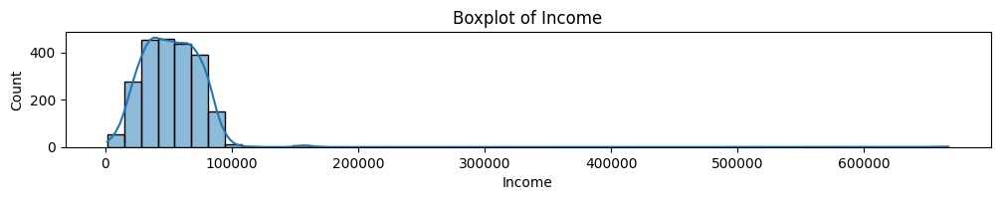

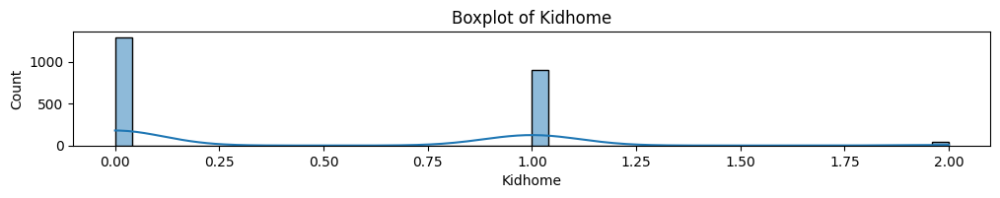

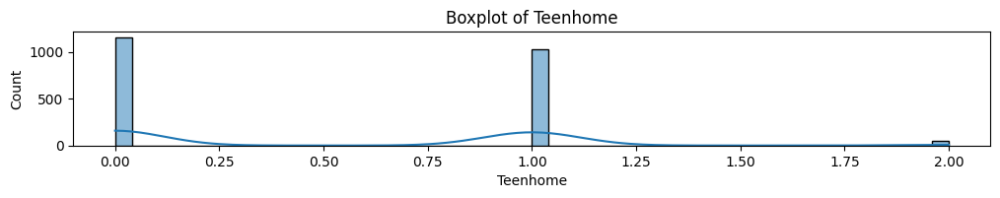

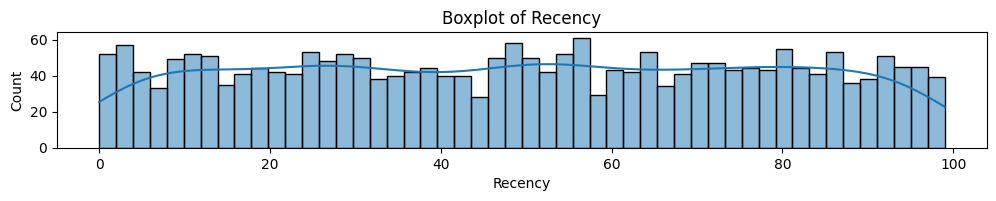

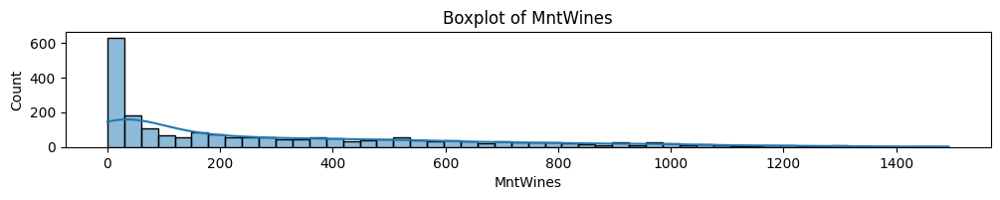

...

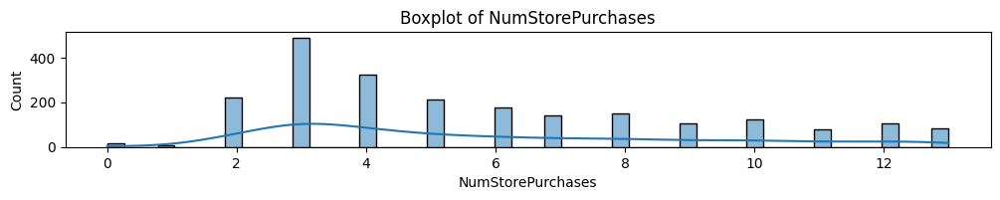

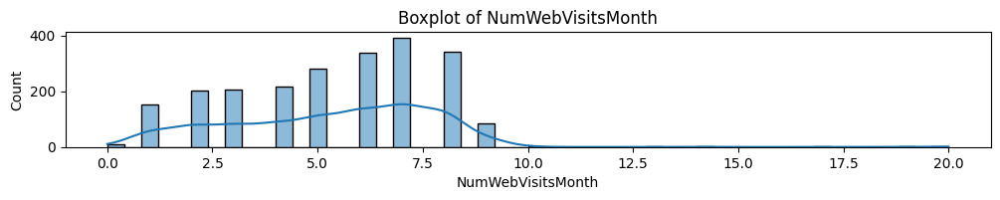

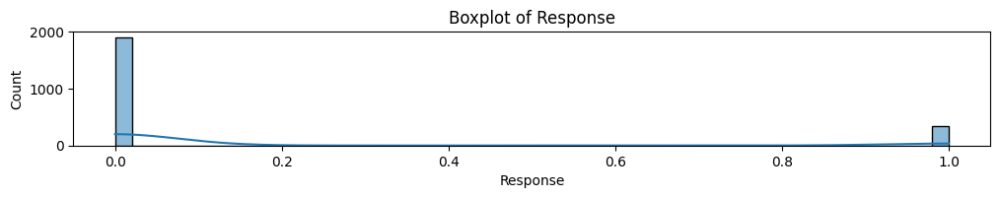

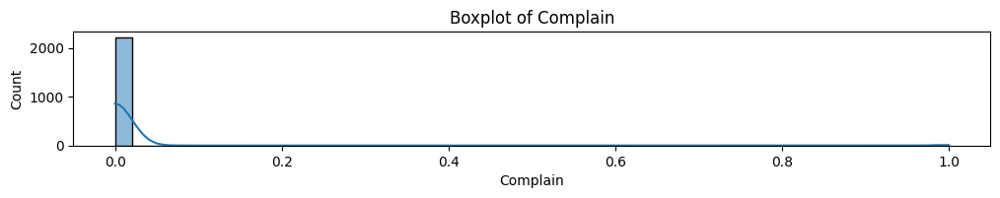

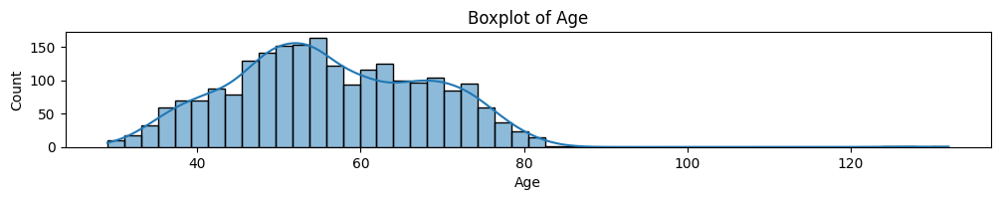

In [ ]:
for col in df_numeric:
    plt.figure(figsize=(12, 1.5))
    sns.histplot(x=df[col], bins = 50 , kde = True)
    plt.title(f'Boxplot of {col}')
    plt.show()

In [ ]:
# Handling Income outlier
# Calculate median income (excluding the outlier)
median_income = df[df['Income'] != 666666]['Income'].median()

# Replace the outlier value
df['Income'] = df['Income'].replace(666666, median_income)

In [ ]:
# Handling Age outlier
# Drop rows where Age is greater than 100 (likely incorrect entries)
df = df[df['Age'] <= 100]

In [ ]:
df.describe(include=['int64', 'float64']).round(2).T

,count,mean,std,min,25%,50%,75%,max
Id,2237.0,5590.73,3245.12,0.0,2829.0,5455.0,8427.0,11191.0
Year_Birth,2237.0,1968.90,11.70,1940.0,1959.0,1970.0,1977.0,1996.0
Income,2237.0,51952.36,21406.68,1730.0,35523.0,51381.5,68274.0,162397.0
Kidhome,2237.0,0.44,0.54,0.0,0.0,0.0,1.0,2.0
Teenhome,2237.0,0.51,0.54,0.0,0.0,0.0,1.0,2.0
Recency,2237.0,49.10,28.96,0.0,24.0,49.0,74.0,99.0
MntWines,2237.0,304.00,336.57,0.0,24.0,174.0,504.0,1493.0
MntFruits,2237.0,26.27,39.72,0.0,1.0,8.0,33.0,199.0
MntMeatProducts,2237.0,166.92,225.66,0.0,16.0,67.0,232.0,1725.0
MntFishProducts,2237.0,37.52,54.64,0.0,3.0,12.0,50.0,259.0


 **Summary: Descriptive Statistics**

- **Statistical measures** such as mean, median, variance, and standard deviation were calculated for all relevant numerical columns to understand central tendencies and data spread.
- An outlier in the **Income** column (`666666`) was identified as a likely data entry error and was removed.
- Although some other income values were slightly higher than typical, they were considered valid and retained.
- Spending-related columns like **MntWines, MntMeatProducts**, etc., showed outliers that were not extreme or unrealistic; these values were kept as they may reflect genuine high-spending customers.
- A few unrealistic values in the **Age** column (e.g., 125, 132) were identified as outliers and removed from the dataset to maintain consistency.




---



###**Task 3 - Probability Distributions 🎲**

This task focuses on identifying which variables in the dataset may follow common probability distributions like the Normal, Binomial, or Poisson distributions. Based on the distribution characteristics, we calculate probabilities and expected values to better understand the behavior and predictability of these variables.

The goal is to apply probability theory to real data and derive meaningful insights that can assist in decision-making or modeling.


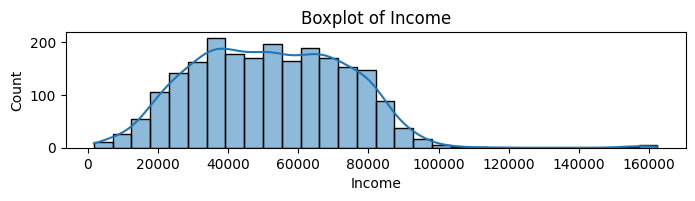

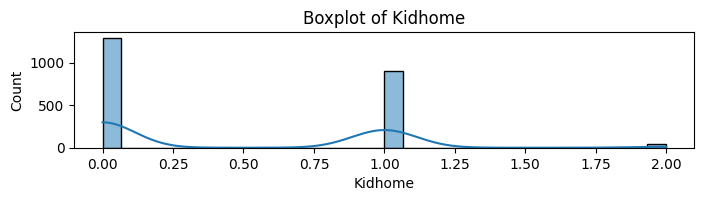

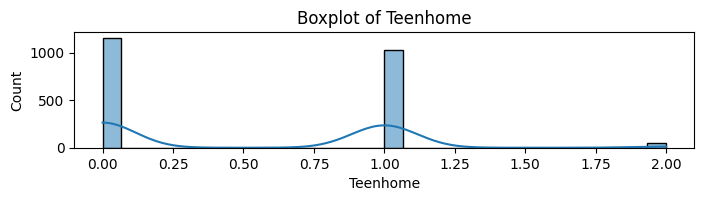

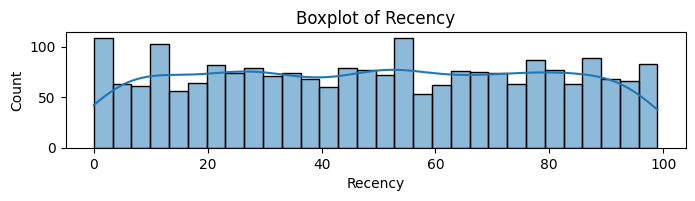

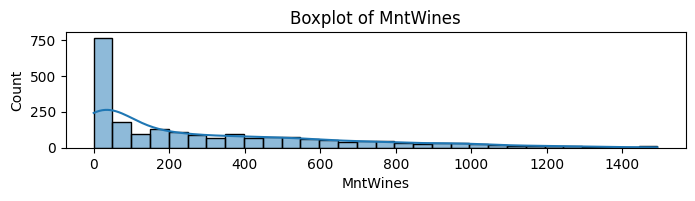

...

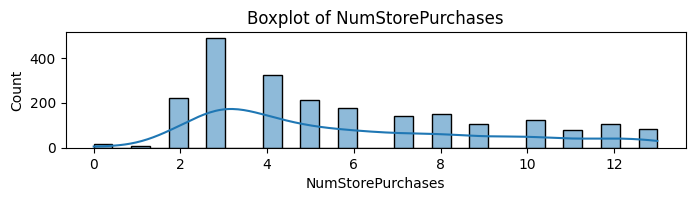

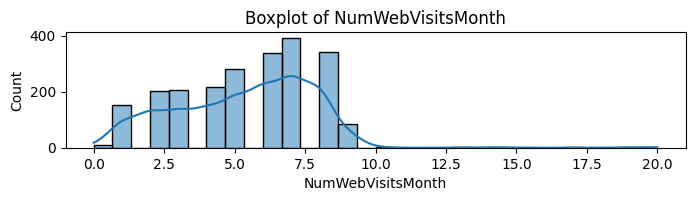

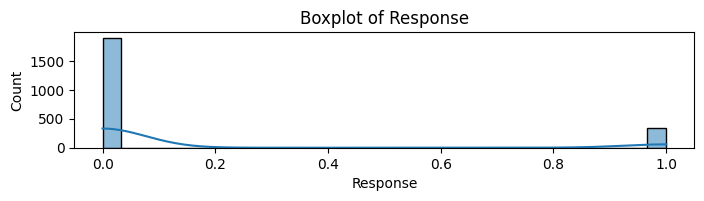

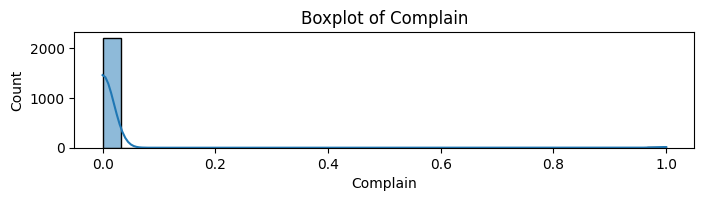

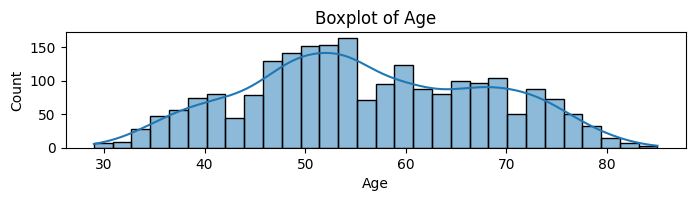

In [ ]:
for col in df_numeric:
    plt.figure(figsize=(8, 1.5))
    sns.histplot(x=df[col], bins = 30 , kde = True)
    plt.title(f'Boxplot of {col}')
    plt.show()

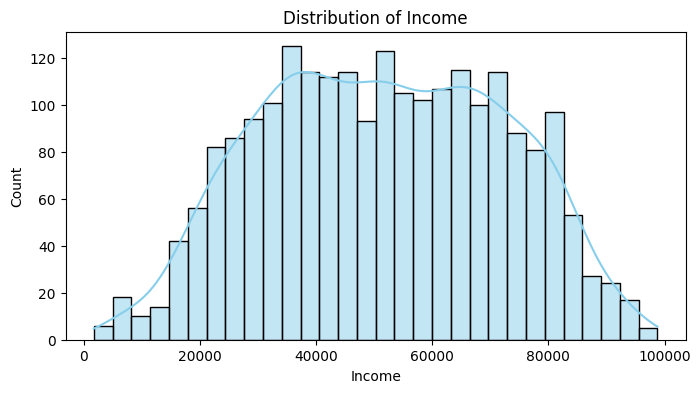

In [ ]:
# Filter income values under 100000
filtered_income = df[df['Income'] < 100000]['Income']

plt.figure(figsize=(8,4))
sns.histplot(filtered_income, kde=True, bins=30, color='skyblue', edgecolor='black')
plt.title('Distribution of Income')
plt.xlabel('Income')
plt.ylabel('Count')
plt.show()

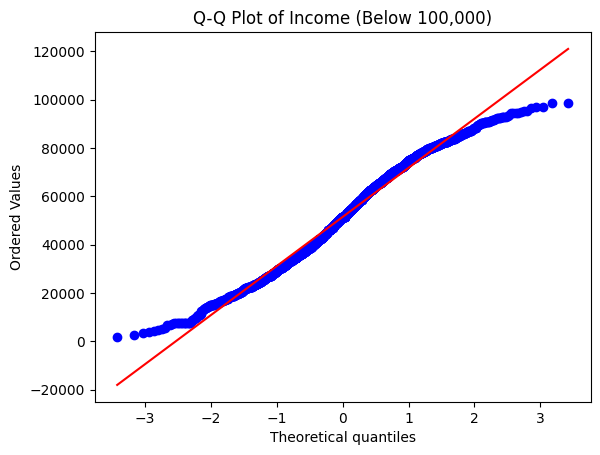

In [ ]:
stats.probplot(filtered_income, dist="norm", plot=plt)
plt.title("Q-Q Plot of Income (Below 100,000)")
plt.show()
# by examine

In [ ]:
from scipy.stats import norm

# For Normal Distribution Probability
def probability_above_threshold(data, threshold):
    """
    Function to calculate the probability of values above a threshold for a given dataset.

    Parameters:
    - data: The data column to be analyzed (e.g., income data)
    - threshold: The threshold value to calculate the probability

    Returns:
    - The probability above the threshold as a percentage
    - To find below, just minus output probability with 1
    """
    # Calculate mean and standard deviation of the data
    mean_data = data.mean()
    std_data = data.std()

    # Calculate the probability of values being above the threshold
    prob_above = 1 - norm.cdf(threshold, loc=mean_data, scale=std_data)

    # Return the probability above the threshold as a percentage
    return (prob_above*100).round(2)

In [ ]:
from scipy.stats import lognorm

# For LogNormal Distribution Probability
def lognorm_prob_above_threshold(data, threshold):
    """
    Calculate the probability of values above a threshold assuming a log-normal distribution.

    Parameters:
    - data: A numeric pandas Series or list (e.g., df['Age'])
    - threshold: The value above which to calculate the probability

    Returns:
    - Probability above the threshold, rounded to 2 decimals
    """
    # Fit log-normal distribution to the data (fix loc to 0 for stability)
    shape, loc, scale = lognorm.fit(data, floc=0)

    # Compute probability that value is greater than the threshold
    prob_above = 1 - lognorm.cdf(threshold, shape, loc=loc, scale=scale)

    return (prob_above*100).round(2)

**Determining Probability for `Income` Above a Given Value and and Expected Value**

In [ ]:
threshold_value = 60000
prob = probability_above_threshold(filtered_income, threshold_value)
print(f"Probability of new customer income above {threshold_value}: {prob}%")
print(f"Expected value: {filtered_income.mean().round(2)} income")

Probability of new customer income above 60000: 33.89%
Expected value: 51498.98 income


**Determining Probability for `Age` Above a Given Value and and Expected Value**

In [ ]:
threshold_value = 50
prob = lognorm_prob_above_threshold(df['Age'], threshold_value)
print(f"Probability of new customer age above {threshold_value}: {prob}%")
print(f"Expected value: {df['Age'].mean().round()} age")

Probability of new customer age above 50: 66.64%
Expected value: 56.0 age


**Complain Rate Probability**

In [ ]:
# 'Complain' column: 1 if the customer complained, 0 otherwise

# Calculate the percentage of customers who complained (i.e., Complain = 1)
complaint_rate = df['Complain'].mean() * 100  # Mean of binary 1s and 0s gives proportion of complaints

# Calculate the percentage of customers who did NOT complain (i.e., Complain = 0)
non_complaint_rate = (1 - df['Complain'].mean()) * 100  # 1 minus the proportion of complaints gives non-complaints

# Print the results with two decimal places
print(f"Probability of a new customer Complaining: {complaint_rate:.2f}%")
print(f"Probability of a new customer Not Complaining: {non_complaint_rate:.2f}%")

Probability of a new customer Complaining: 0.89%
Probability of a new customer Not Complaining: 99.11%


**Response Rate Probability**

In [ ]:
# 'Response' column: 1 if customer accepted the offer, 0 otherwise

# Calculate the percentage of customers who accepted the offer (i.e., Response = 1)
response_rate = df['Response'].mean() * 100  # Mean of binary 1s and 0s gives proportion of 1s

# Calculate the percentage of customers who did NOT accept the offer (i.e., Response = 0)
non_response_rate = (1 - df['Response'].mean()) * 100  # 1 minus the proportion of 1s gives proportion of 0s

# Print the results with two decimal places
print(f"Probability of a new customer Accepting the Offer: {response_rate:.2f}%")
print(f"Probability of a new customer Not Accepting the Offer: {non_response_rate:.2f}%")

Probability of a new customer Accepting the Offer: 14.93%
Probability of a new customer Not Accepting the Offer: 85.07%


**Probability od total visits by customer in a month**

In [ ]:
# Filter the DataFrame to include only rows where NumWebVisitsMonth is less than 11
filtered_MonthlyVisits = df[df['NumWebVisitsMonth'] <= 10.0]['NumWebVisitsMonth']

In [ ]:
from scipy.stats import poisson

lambda_monthly = filtered_MonthlyVisits.mean()
n_visits = 7

# Cumulative probability: P(X ≤ 7)
prob_n_visits = poisson.cdf(n_visits, mu=lambda_monthly)

print(f"Probability of total {n_visits} visits in a month: {(1-prob_n_visits)*100:.2f}%")
print(f"Expected value: {lambda_monthly.round()} visits")

Probability of total 7 visits in a month: 16.31%
Expected value: 5.0 visits




---



###**Task 4: Insights and Customer Segmentation 📈**

This task focuses on analyzing relationships between customer characteristics (such as age, income, marital status, and education) and their purchasing behavior. By creating new grouped columns like age groups and income levels, customers are segmented into meaningful categories. This allows for better understanding of how different types of customers spend and behave, helping to uncover key patterns and insights.

**Customer Segmentation**

In [ ]:
Products = ['MntWines', 'MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts', 'MntGoldProds']

In [ ]:
# Define bins and labels for age groups
bins = [0, 29, 39, 49, 59, 69, 140]
labels = ['<30', '30-39', '40-49', '50-59', '60-69', '70+']

# Assign 'Age_Group' column with the correct binning
df.loc[:, 'Age_Group'] = pd.cut(df['Age'], bins=bins, labels=labels, right=True)

<ipython-input-54-4b74a2d6067a>:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
# Define custom income bins
bins = [0, 40000, 70000, df['Income'].max()]  # Example cutoffs: <40K, 40K–70K, >70K
labels = ['Low', 'Medium', 'High']

# Create Income_Level column using bins
df.loc[:, 'Income_Level'] = pd.cut(df['Income'], bins=bins, labels=labels, include_lowest=True)

<ipython-input-55-72a732bd37d9>:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
# total spending
df.loc[:, 'TotalSpending'] = df[Products].sum(axis=1)

<ipython-input-56-1419235a8816>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
# bin edges and labels
bins = [0, 500, 1400, df['TotalSpending'].max()]
labels = ['Low', 'Medium', 'High']

# Create the SpenderSegment column using pd.cut()
df.loc[:,'SpenderType'] = pd.cut(df['TotalSpending'], bins=bins, labels=labels, include_lowest=True)

**Correlation Matrix**

In [ ]:
df_numeric = df.select_dtypes(include=['int64', 'float64'])

df_numeric.drop(["Id","Year_Birth"], axis=1, inplace=True)

In [ ]:
correlation_matrix = df_numeric.corr()
correlation_matrix

,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Response,Complain,Age,TotalSpending
Income,1.000000,-0.510331,0.034320,0.007839,0.685973,0.504904,0.684117,0.518434,0.518088,0.383523,-0.107161,0.450574,0.693738,0.627982,-0.646374,0.161120,-0.027870,0.198822,0.789241
Kidhome,-0.510331,1.000000,-0.035753,0.007544,-0.496367,-0.372488,-0.437059,-0.387536,-0.370656,-0.349633,0.221799,-0.362063,-0.502438,-0.500387,0.447641,-0.080176,0.036283,-0.234133,-0.556902
Teenhome,0.034320,-0.035753,1.000000,0.017115,0.005409,-0.175951,-0.260820,-0.203900,-0.162218,-0.020186,0.387792,0.155776,-0.110285,0.050517,0.134491,-0.154730,0.007591,0.363350,-0.137769
Recency,0.007839,0.007544,0.017115,1.000000,0.016668,-0.003592,0.023705,0.001532,0.023045,0.017412,-0.000987,-0.010616,0.025449,0.001117,-0.021959,-0.198568,0.005398,0.019670,0.021199
MntWines,0.685973,-0.496367,0.005409,0.016668,1.000000,0.388518,0.561993,0.399073,0.385992,0.386376,0.010829,0.542177,0.634784,0.642433,-0.320337,0.247392,-0.035930,0.163035,0.891734
MntFruits,0.504904,-0.372488,-0.175951,-0.003592,0.388518,1.000000,0.542057,0.594438,0.567054,0.390042,-0.131886,0.297024,0.487307,0.463168,-0.417427,0.125904,-0.002800,0.013751,0.613122
MntMeatProducts,0.684117,-0.437059,-0.260820,0.023705,0.561993,0.542057,1.000000,0.567880,0.523418,0.348845,-0.122465,0.293579,0.723519,0.480110,-0.539203,0.236640,-0.020720,0.030927,0.842655
MntFishProducts,0.518434,-0.387536,-0.203900,0.001532,0.399073,0.594438,0.567880,1.000000,0.579553,0.422103,-0.139440,0.293489,0.534033,0.460099,-0.445760,0.111415,-0.018818,0.042519,0.642395
MntSweetProducts,0.518088,-0.370656,-0.162218,0.023045,0.385992,0.567054,0.523418,0.579553,1.000000,0.369193,-0.120278,0.348304,0.490497,0.448801,-0.423249,0.117366,-0.020404,0.019571,0.602701
MntGoldProds,0.383523,-0.349633,-0.020186,0.017412,0.386376,0.390042,0.348845,0.422103,0.369193,1.000000,0.049942,0.422731,0.436997,0.383264,-0.249093,0.140693,-0.029874,0.057599,0.522762


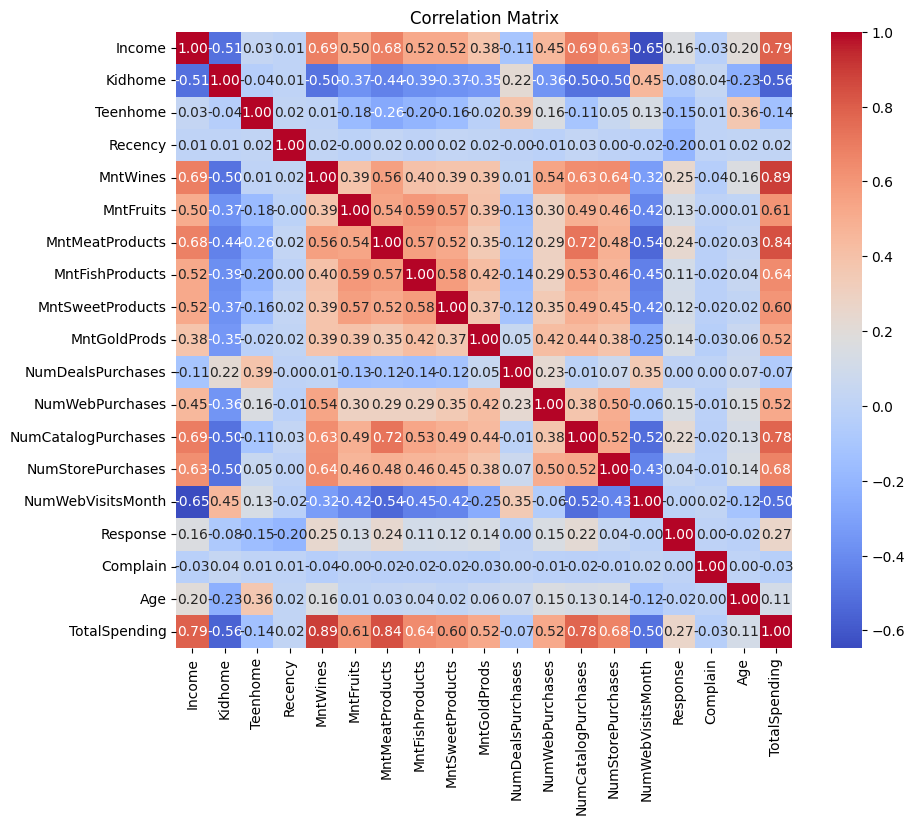

In [ ]:
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", square=True)
plt.title("Correlation Matrix")
plt.show()

**Customer Spending Behavior**

In [ ]:
# Total spends for each product category
total_spends = df[Products].sum()

# Create a DataFrame for better visualization
total_spends_df = pd.DataFrame({'Product Category': total_spends.index, 'Total Spend': total_spends.values})

# Display the total spends for each product category
total_spends_df.sort_values(by='Total Spend', ascending=False, ignore_index=True)

,Product Category,Total Spend
0,MntWines,680038
1,MntMeatProducts,373393
2,MntGoldProds,98358
3,MntFishProducts,83939
4,MntSweetProducts,60553
5,MntFruits,58767


In [ ]:
# Average spends for each product category (excluding 0s)
avg_spends = df[Products].apply(lambda x: x[x > 0].mean())

# Create a DataFrame for better visualization
avg_spends_df = pd.DataFrame({'Product Category': avg_spends.index, 'Average Spend': avg_spends.values})

# Display the average spends for each product category
avg_spends_df.sort_values(by='Average Spend', ascending=False, ignore_index=True).round(2)


,Product Category,Average Spend
0,MntWines,305.77
1,MntMeatProducts,166.99
2,MntFishProducts,45.30
3,MntGoldProds,45.20
4,MntSweetProducts,33.29
5,MntFruits,31.97


In [ ]:
print("Income Level with Highest Total Spending for Each Product:\n")
for i in Products:
    group = df.groupby('Income_Level', observed=True)[i].sum()
    top = group.idxmax()
    top_value = group.max()
    print(f"{i} - {top} Income Level (${top_value:.2f})")

Income Level with Highest Total Spending for Each Product:

MntWines - Medium Income Level ($333254.00)
MntFruits - High Income Level ($31287.00)
MntMeatProducts - High Income Level ($225058.00)
MntFishProducts - High Income Level ($45318.00)
MntSweetProducts - High Income Level ($33908.00)
MntGoldProds - Medium Income Level ($48551.00)


In [ ]:
print("Income Level with Highest Average Spending for Each Product:\n")
for i in Products:
    group = df.groupby('Income_Level', observed=True)[i].mean()
    top = group.idxmax()
    top_value = group.max()
    print(f"{i} - {top} Income Level (${top_value:.2f})")

MntWines - High Income Level ($642.12)
MntFruits - High Income Level ($64.91)
MntMeatProducts - High Income Level ($444.78)
MntFishProducts - High Income Level ($94.61)
MntSweetProducts - High Income Level ($71.84)
MntGoldProds - High Income Level ($75.15)


In [ ]:
print("Age Group with Highest Total Spending for Each Product:\n")
for i in Products:
    group = df.groupby('Age_Group', observed=True)[i].sum()
    top = group.idxmax()
    top_value = group.max()
    print(f"{i} - {top} Age Group (${top_value:.2f})")

Age Group with Highest Total Spending for Each Product:

MntWines - 50-59 Age Group ($194660.00)
MntFruits - 50-59 Age Group ($16151.00)
MntMeatProducts - 50-59 Age Group ($100184.00)
MntFishProducts - 50-59 Age Group ($22807.00)
MntSweetProducts - 50-59 Age Group ($17093.00)
MntGoldProds - 50-59 Age Group ($27129.00)


In [ ]:
print("Age Group with Highest Average Spending for Each Product:\n")
for i in Products:
    group = df.groupby('Age_Group', observed=True)[i].mean()
    top = group.idxmax()
    top_value = group.max()
    print(f"{i} - {top} Age Group (${top_value:.2f})")

Age Group with Highest Average Spending for Each Product:

MntWines - 70+ Age Group ($397.33)
MntFruits - 30-39 Age Group ($33.05)
MntMeatProducts - 30-39 Age Group ($222.83)
MntFishProducts - 70+ Age Group ($43.62)
MntSweetProducts - 30-39 Age Group ($34.59)
MntGoldProds - 70+ Age Group ($51.92)


In [ ]:
print("Education Level with Highest Total Spending for Each Product:\n")
for i in Products:
    group = df.groupby('Education', observed=True)[i].sum()
    top = group.idxmax()
    top_value = group.max()
    print(f"{i} - {top} (${top_value:.2f})")

Education Level with Highest Total Spending for Each Product:

MntWines - Graduation ($320371.00)
MntFruits - Graduation ($34683.00)
MntMeatProducts - Graduation ($202284.00)
MntFishProducts - Graduation ($48630.00)
MntSweetProducts - Graduation ($35351.00)
MntGoldProds - Graduation ($57307.00)


In [ ]:
print("Education Level with Highest Average Spending for Each Product:\n")
for i in Products:
    group = df.groupby('Education', observed=True)[i].mean()
    top = group.idxmax()
    top_value = group.max()
    print(f"{i} - {top} (${top_value:.2f})")

Education Level with Highest Average Spending for Each Product:

MntWines - PhD ($403.77)
MntFruits - Graduation ($30.77)
MntMeatProducts - Graduation ($179.49)
MntFishProducts - 2n Cycle ($47.89)
MntSweetProducts - 2n Cycle ($34.57)
MntGoldProds - Graduation ($50.85)


In [ ]:
print("Marital Status with Highest Total Spending for Each Product:\n")
for i in Products:
    group = df.groupby('Marital_Status', observed=True)[i].sum()
    top = group.idxmax()
    top_value = group.max()
    print(f"{i} - {top} (${top_value:.2f})")

Marital Status with Highest Total Spending for Each Product:

MntWines - Married ($258751.00)
MntFruits - Married ($22235.00)
MntMeatProducts - Married ($138829.00)
MntFishProducts - Married ($30569.00)
MntSweetProducts - Married ($23070.00)
MntGoldProds - Married ($36999.00)


In [ ]:
print("Marital Status with Highest Averge Spending for Each Product:\n")
for i in Products:
    group = df.groupby('Marital_Status', observed=True)[i].mean()
    top = group.idxmax()
    top_value = group.max()
    print(f"{i} - {top} (${top_value:.2f})")

Marital Status with Highest Averge Spending for Each Product:

MntWines - Widow ($369.27)
MntFruits - Absurd ($84.50)
MntMeatProducts - Absurd ($312.50)
MntFishProducts - Absurd ($205.50)
MntSweetProducts - Widow ($39.01)
MntGoldProds - Absurd ($204.00)




---



###**Task 5: Conclusion and Recommendations 💭**


In this final section, we consolidate the key insights derived from our data analysis and present them using clear, well-designed visualizations. These findings help us understand customer behaviors, preferences, and characteristics. Based on these insights, we provide actionable recommendations that the company can implement to enhance customer engagement, boost sales, and optimize marketing strategies.

####Average Total Spend by Age Group

In [ ]:
avg_spend_by_age = df.groupby('Age_Group', observed=True)['TotalSpending'].mean().reset_index()

fig = px.bar(avg_spend_by_age, x='Age_Group', y='TotalSpending', color='Age_Group',
             title='Average Total Spend by Age Group')
fig.update_layout(xaxis_title='Age Group', yaxis_title='Average Total Spend', showlegend=False)
fig.show()

In [ ]:
for product in Products:
    avg_spend = df[df[product] > 0].groupby('Age_Group', observed=True)[product].mean().reset_index()
    fig = px.bar(avg_spend, x='Age_Group', y=product, color='Age_Group',
                 title=f'Average Spend on {product} by Age Group')
    fig.update_layout(xaxis_title='Age Group', yaxis_title='Average Spend')
    fig.show()

**Key Insights**

* Customers aged 50-59 have the highest average spend, indicating they are frequent purchasers. This age group also represents a major portion of the customer base, making them a highly valuable segment.

* Age groups 60-69 and 70+ also show high average spending across almost all product categories, reinforcing that older and middle-aged customers are the primary buyers.

* The under-30 age group has the lowest average spend, suggesting that this demographic is less engaged. This may warrant further analysis to understand the reasons—such as income constraints or product relevance—and potentially develop youth-targeted offers to increase engagement.



####Spender Segment Distribution

In [ ]:
# Create a pie chart for SpenderType distribution
fig = px.pie(df, names='SpenderType', title='Spender Segment Distribution',width=700, height=500 )

fig.show()

**Key Insights**

* The low spender segment dominates the customer base at 55.6%, followed by medium and high spenders.

* To increase revenue, we can:

 * Offer budget-friendly products and targeted discounts to encourage low spenders to purchase more.

 * Design promotions that nudge low spenders into the medium spender bracket.
* High spenders (13.2%), although a smaller group, are niche customers less influenced by discounts. It’s crucial not to overlook them; we should maintain a range of premium and high-quality offerings to cater to their preferences.

####Average Total Spend by Product Category

In [ ]:
avg_spends = df[Products][df[Products].gt(0).any(axis=1)].mean().reset_index()
avg_spends.columns = ['Product', 'Average Spend']

fig = px.bar(avg_spends, x='Average Spend', y='Product', orientation='h',
             title='Average Spend by Product Category', color='Average Spend')
fig.update_layout(yaxis={'categoryorder': 'total ascending'})
fig.show()

**Key Insights**

* Wines show the highest average spend, likely due to their higher price points.

* Interestingly, meat products also show a high average spend, despite being relatively less expensive, suggesting that they are purchased more frequently.

* This opens opportunities for cross-selling strategies, especially recommending meat products. However, dietary preferences matter—if the customer is vegetarian, this would be ineffective. Capturing dietary preference data would help tailor recommendations better.

####Average Total Spend by Income Level

In [ ]:
for product in Products:
    avg_spend = df[df[product] > 0].groupby('Income_Level', observed=True)[product].mean().reset_index()
    fig = px.bar(avg_spend, x='Income_Level', y=product, color='Income_Level',
                 title=f'Average Spend on {product} by Income Level')
    fig.update_layout(xaxis_title='Income Level', yaxis_title='Average Spend')
    fig.show()

**Key Insights**

* As expected, customers with an income above 70,000 have the highest average spend across all product categories.

* These high-income customers particularly spend more on wines and meat, suggesting a preference for premium or luxury items. Offering niche, high-margin products to this group may lead to increased sales and profitability.

####Average Total Spend by Education Level

In [ ]:
for product in Products:
    avg_spend = df[df[product] > 0].groupby('Education', observed=True)[product].mean().reset_index()
    fig = px.bar(avg_spend, x='Education', y=product, color='Education',
                 title=f'Average Spend on {product} by Education Level')
    fig.update_layout(xaxis_title='Education Level', yaxis_title='Average Spend')
    fig.show()

**Key Insights**

* Customers with higher education levels (Graduation, Master's, 2nd Cycle, PhD) have relatively similar average spending patterns, indicating that education correlates with higher purchasing power.

* In contrast, customers with basic education have significantly lower average spend, which may reflect lower income levels or different priorities.

####Average Total Spend by Marital Status

In [ ]:
for product in Products:
    avg_spend = df[df[product] > 0].groupby('Marital_Status', observed=True)[product].mean().reset_index()
    fig = px.bar(avg_spend, x='Marital_Status', y=product, color='Marital_Status',
                 title=f'Average Spend on {product} by Marital Status')
    fig.update_layout(xaxis_title='Marital Status', yaxis_title='Average Spend')
    fig.show()

**Key Insights**

* Widowed customers show the highest average spend across every product category. This group could be targeted with dedicated campaigns or personalized offers to increase engagement and brand loyalty.

* Other marital groups—single, married, divorced—have relatively similar spending patterns, indicating a balanced approach to marketing across these segments.

#### Customer Offer Acceptance & Complaint Rate

In [ ]:
fig = px.pie(df, names='Response', title='Response Rate (0 = No, 1 =Yes)',width=700, height=500 )

fig.show()

In [ ]:
fig = px.pie(df, names='Complain', title='Complain Rate (0 = No, 1 =Yes)',width=700, height=500 )

fig.show()

**Key Insights:**

**1. Offer Acceptance Rate**
- **14.93%** of customers are likely to **accept marketing offers**, while a significant **85.07% do not**.
  - This suggests that **current marketing campaigns may not be effectively targeting or engaging most customers**.
  - **Actionable Insight**:
    - Analyze the characteristics (e.g., age, income, education) of those who accepted offers and create **segmented, personalized campaigns**.
    - Consider **A/B testing** offers with different discounts, product bundles, or delivery perks to increase engagement.
    - Use **predictive modeling** to target only those likely to accept, increasing campaign efficiency.

**2. Complaint Rate**
- Only **0.89% of customers have filed complaints**, while **99.11% have not**.
  - This indicates **overall high customer satisfaction or low complaint reporting**.
  - **Actionable Insight**:
    - While the complaint rate is low, it’s essential to assess if it’s due to **genuinely good service or underreporting**.
    - Consider implementing **post-purchase surveys or feedback forms** to proactively capture dissatisfaction.
    - Use complaint data to identify recurring issues and **strengthen quality control or customer service**.


#### 📌 **Conclusion**

This analysis of customer purchase behavior revealed clear patterns across age, income, education, marital status, and spending habits. Most customers fall into the **middle-aged or older segment** (ages 30+), with the **50–59 age group** being the highest spenders. Products like **wine and meat** have the highest average spend, particularly among customers with **high income and advanced education**. Despite a **low offer acceptance rate (14.93%)**, complaint rates are also remarkably low (0.89%), suggesting overall customer satisfaction.

The **majority of customers are low spenders**, which highlights a gap between broad customer engagement and actual purchase value. There’s clear potential for targeted strategies to **upsell** and **cross-sell** to different segments.

---

#### ✅ **Key Recommendations**

1. **Target Middle-Aged and Older Segments (30–69 years):**  
   These groups consistently show high spending behavior. Focus campaigns and product bundles for this demographic.

2. **Boost Engagement Among Low Spenders (<55.6%):**  
   Offer **budget-friendly packs**, **seasonal deals**, and **personalized offers** to encourage upselling.

3. **Increase Conversion for Under-30 Segment:**  
   Investigate **why younger customers spend less** (pricing, product fit, marketing disconnect) and tailor campaigns to attract this group.

4. **Segment-Based Product Recommendations:**  
   - Recommend **meat and wine** to non-vegetarian high-income customers.
   - Consider using preference data (e.g., veg/non-veg) to **avoid irrelevant recommendations**.

5. **Focus on High-Income Customers with Premium Products:**  
   These customers spend more, especially on luxury or specialty items. Promote **exclusive or niche products** for this segment.

6. **Special Campaigns for Widowed Customers:**  
   This group shows the highest spending behavior—offering **personalized loyalty benefits or support-driven offers** could enhance brand connection.


---


#### 📊 **Takeaways**

- **Spending increases with age, income, and education level.**
- **Low-spending customers dominate** the customer base—this is both a challenge and an opportunity.
- Product-specific insights show that **meat and wine are top revenue drivers**.
- Despite low campaign success (14.93%), the **customer experience appears positive**, indicated by minimal complaints.
- Personalized marketing, segmentation, and strategic product targeting can **significantly improve offer acceptance and customer retention**.
